# [IAPR][iapr]: Final project - Chocolate Recognition


**Moodle group ID:** *01*  
**Kaggle challenge:** *Deep learning* (either `Classic` or `Deep learning`)  
**Kaggle team name (exact):** "*group 1*"  

**Author 1 (sciper):** Alessio Zazo 1 (328450)  
**Author 2 (sciper):** Gautier Demierre 2 (340423)   
**Author 3 (sciper):** Georg Schwabedal 3 (328434)   

**Due date:** 21.05.2025 (11:59 pm)


## Key Submission Guidelines:
- **Before submitting your notebook, <span style="color:red;">rerun</span> it from scratch!** Go to: `Kernel` > `Restart & Run All`
- **Only groups of three will be accepted**, except in exceptional circumstances.


[iapr]: https://github.com/LTS5/iapr2025

---

# 📖 1. Introduction

The **Chocolate Recognition Task** is a computer vision challenge part of the IAPR 2025 project, where the objective is to automatically detect and count different types of chocolates present in high-resolution images of chocolate boxes.

There are **13 chocolate classes**, each with unique visual features, shapes, and textures. The task is challenging due to occlusions, overlaps, lighting variations, and class imbalance.

### 🎯 Goal

The goal of the task is to generate, for each test image, a submission file reporting how many instances of each chocolate type appear in the image.

This requires:
- Segmenting chocolate regions from the image.
- Classifying each segmented region into one of the 13 classes.
- Accurately counting and reporting the occurrences.

### 🧪 Task Variants

There are two competition tracks:
- **Classic Track**: Solving the task without any deep learning.
- **Machine Learning Track**: Leveraging deep learning-based models.

For this project, we chose the **Machine Learning Track**, implementing a U-Net for segmentation and a CNN-based classifier for recognition. The system is designed to be modular, accurate, and fully reproducible.

---

## 2. Dataset Preparation and Labeling

The original dataset provided for this project consists of:

- **90 training images**: high-resolution (6000×4000), captured under consistent conditions using the same camera, lighting, and distance. These images are annotated with *weak labels* (i.e., chocolate counts per image).
- **180 testing images**: similarly structured, used for evaluating model performance.
- **13 chocolate categories**: each with at least one reference image.

Images were taken across **7 distinct background types**, with some including **distractor objects** to simulate real-world complexity.

### 🍫 Manual Annotation

To move beyond weak labels, we manually annotated the training images using the **Mask AI** platform. This web-based annotation tool allowed us to draw segmentation masks for each chocolate in every image. The annotations were exported in **COCO JSON format**.

---

## 🔹 2.1 Preparing Labeled Masks and Labels for U-Net (Code 1)

We parsed the COCO `.json` file to extract:
- **Binary segmentation masks**: one `.png` file per image, where all chocolates are marked with white pixels.
- **Label files**: `.json` dictionaries storing the count of each chocolate type in an image.

---

Steps:
- Each annotation polygon was drawn onto a binary mask using `PIL.ImageDraw`.
- A label file was generated by counting the number of annotations per category.
- Labels were normalized to match the format used in the official `train.csv`.

This resulted in two directories:
- `train/Masks`: used as U-Net targets.
- `train/Labels`: for label-based verification.

We compared these outputs to the official `train.csv` to verify consistency.

---

In [1]:
import os
import json
import unicodedata
from PIL import Image, ImageDraw
from collections import defaultdict, Counter
from tqdm import tqdm
import pandas as pd

# --- Paths ---
json_path = "src/data/labels_mask_ai.json"
train_csv_path = "src/data/dataset_project_iapr2025/train.csv"
train_dir = "src/data/dataset_project_iapr2025/train"
mask_out_dir = os.path.join(train_dir, "Masks")
label_out_dir = os.path.join(train_dir, "Labels")
os.makedirs(mask_out_dir, exist_ok=True)
os.makedirs(label_out_dir, exist_ok=True)

# --- Load files ---
with open(json_path, "r") as f:
    data = json.load(f)

train_df = pd.read_csv(train_csv_path)

# --- Category map (1-indexed) ---
category_id_to_label = {
    1: "Triangolo",
    2: "Jelly White",
    3: "Jelly Milk",
    4: "Jelly Black",
    5: "Amandina",
    6: "Crème brûlée",
    7: "Tentation Noir",
    8: "Arabia",
    9: "Comtesse",
    10: "Noblesse",
    11: "Passion au lait",
    12: "Stracciatella",
    13: "Noir authentique"
}

# --- Normalization & fix ---
def normalize_and_fix_label(label):
    normalized = unicodedata.normalize("NFC", label)
    if normalized == "Crème brûlée":
        return "Crème brulée"
    if normalized == "Tentation Noir":
        return "Tentation noir"
    return normalized

# --- Metadata & group annotations ---
image_id_to_filename = {img["id"]: img["file_name"] for img in data["images"]}
image_id_to_size = {img["id"]: (img["width"], img["height"]) for img in data["images"]}
annotations_by_image = defaultdict(list)
for ann in data["annotations"]:
    annotations_by_image[ann["image_id"]].append(ann)

# --- Generate masks & labels ---
actual_labels = {}
for img_id, anns in tqdm(annotations_by_image.items(), desc="Processing images"):
    filename = image_id_to_filename[img_id]
    width, height = image_id_to_size[img_id]
    base_name = filename[1:filename.index(".")]  # e.g., 'L1000756.JPG' → '1000756'

    # Create mask
    mask = Image.new("L", (width, height), 0)
    draw = ImageDraw.Draw(mask)

    label_counter = Counter()
    for ann in anns:
        cat_id = ann["category_id"]
        label_counter[cat_id] += 1
        for segmentation in ann["segmentation"]:
            if len(segmentation) >= 6:
                polygon = [(segmentation[i], segmentation[i + 1]) for i in range(0, len(segmentation), 2)]
                draw.polygon(polygon, outline=255, fill=255)

    # Save mask
    mask_path = os.path.join(mask_out_dir, f"{base_name}_mask.png")
    mask.save(mask_path)

    # Save labels
    label_data = {
        normalize_and_fix_label(category_id_to_label.get(k, f"Unknown_{k}")): v for k, v in label_counter.items()
    }
    label_path = os.path.join(label_out_dir, f"{base_name}.json")
    with open(label_path, "w") as label_file:
        json.dump(label_data, label_file)

    actual_labels[base_name] = label_data

# --- Compare with train.csv ---
mismatch_details = []
for _, row in train_df.iterrows():
    img_id = str(row["id"])
    expected = {normalize_and_fix_label(k): v for k, v in row.drop("id").to_dict().items()}
    actual = actual_labels.get(img_id, {})

    mismatched_cols = [k for k in expected if expected[k] != actual.get(k, 0)]
    if mismatched_cols:
        mismatch_details.append({
            "Image ID": img_id,
            "Expected": {k: expected[k] for k in mismatched_cols},
            "Actual": {k: actual.get(k, 0) for k in mismatched_cols}
        })

# --- Print mismatches ---
mismatch_df = pd.DataFrame(mismatch_details)
print(mismatch_df)

Processing images: 100%|██████████| 90/90 [00:06<00:00, 14.95it/s]

  Image ID                             Expected  \
0  1000780  {'Jelly Milk': 1, 'Jelly Black': 1}   

                                Actual  
0  {'Jelly Milk': 2, 'Jelly Black': 0}  



## 🔹 2.2 Generating Synthetic U-Net Training Data (Code 1b)

To further diversify the U-Net training data:
- We extracted chocolate regions from the masks.
- Randomly pasted them onto clean background images (from the real dataset).
- Ensured no overlaps using connected component analysis.
- Saved 1000 new images and masks in:
  - `synthetic_data/images/`
  - `synthetic_data/masks/`

---

In [2]:
import os
import shutil
import random
import numpy as np
from PIL import Image
from tqdm import tqdm
from scipy.ndimage import label, find_objects

# --- Paths ---
train_dir = "src/data/dataset_project_iapr2025/train"
train_mask_dir = os.path.join(train_dir, "Masks")
out_img_dir = "src/data/synthetic_UNET/images"
out_mask_dir = "src/data/synthetic_UNET/masks"

# --- Setup ---
shutil.rmtree(out_img_dir, ignore_errors=True)
shutil.rmtree(out_mask_dir, ignore_errors=True)
os.makedirs(out_img_dir, exist_ok=True)
os.makedirs(out_mask_dir, exist_ok=True)

# --- Step 1: Extract chocolate crops from training set ---
choco_data = []

for name in os.listdir(train_mask_dir):
    if not name.endswith("_mask.png"):
        continue

    base = name.replace("_mask.png", "")
    img_path = os.path.join(train_dir, f"L{base}.JPG")  # correct L prefix
    mask_path = os.path.join(train_mask_dir, name)

    if not os.path.exists(img_path):
        continue

    rgb = np.array(Image.open(img_path).convert("RGB"))
    mask = np.array(Image.open(mask_path).convert("L"))
    binary_mask = (mask > 127).astype(np.uint8)

    labeled_array, _ = label(binary_mask)
    objects = find_objects(labeled_array)

    for obj_slice in objects:
        y1, y2 = obj_slice[0].start, obj_slice[0].stop
        x1, x2 = obj_slice[1].start, obj_slice[1].stop
        crop_img = rgb[y1:y2, x1:x2]
        crop_mask = (binary_mask[y1:y2, x1:x2] * 255).astype(np.uint8)
        choco_data.append((crop_img, crop_mask))

print(f"🍫 Extracted {len(choco_data)} chocolate crops.")

# --- Step 2: Load backgrounds (just full training images) ---
bg_sources = []
for name in os.listdir(train_mask_dir):
    if not name.endswith("_mask.png"):
        continue

    base = name.replace("_mask.png", "")
    img_path = os.path.join(train_dir, f"L{base}.JPG")
    mask_path = os.path.join(train_mask_dir, name)
    if not os.path.exists(img_path):
        continue

    img = np.array(Image.open(img_path).convert("RGB"))
    mask = np.array(Image.open(mask_path).convert("L"))
    mask = (mask > 127).astype(np.uint8) * 255
    bg_sources.append((img, mask))

print(f"🖼️ Loaded {len(bg_sources)} backgrounds.")

# --- Step 3: Generate synthetic dataset ---
for i in tqdm(range(1000), desc="Generating synthetic images"):
    bg_img, bg_mask = random.choice(bg_sources)
    new_img = bg_img.copy()
    new_mask = bg_mask.copy()

    H, W = new_mask.shape
    num_chocos = random.randint(1, 5)

    for _ in range(num_chocos):
        crop_img, crop_mask = random.choice(choco_data)

        # Optional: simple rotation (no scaling)
        angle = random.choice([0, 90, 180, 270])
        crop_img = Image.fromarray(crop_img).rotate(angle, expand=True)
        crop_mask = Image.fromarray(crop_mask).rotate(angle, expand=True)

        crop_img = np.array(crop_img)
        crop_mask = np.array(crop_mask)

        h, w = crop_mask.shape
        for attempt in range(30):  # try to find an empty spot
            x = random.randint(0, W - w)
            y = random.randint(0, H - h)
            region = new_mask[y:y+h, x:x+w]
            if np.sum(region) == 0:
                # Paste crop
                mask_bool = crop_mask > 0
                new_img[y:y+h, x:x+w][mask_bool] = crop_img[mask_bool]
                new_mask[y:y+h, x:x+w][mask_bool] = 255
                break

    # Save results
    Image.fromarray(new_img).save(os.path.join(out_img_dir, f"syn_{i:04d}.png"))
    Image.fromarray(new_mask).save(os.path.join(out_mask_dir, f"syn_{i:04d}_mask.png"))

print("✅ Synthetic data generation complete.")


🍫 Extracted 594 chocolate crops.
🖼️ Loaded 90 backgrounds.


Generating synthetic images: 100%|██████████| 1000/1000 [52:50<00:00,  3.17s/it]  

✅ Synthetic data generation complete.


## 🔹 2.3 Extracting Patches for CNN Classifier (Code 2)

For the CNN classifier, we needed high-resolution crops of each chocolate:
- Using the annotations, we extracted tight crops around each chocolate.
- We applied **random rotations** (90°, 180°, etc.) for augmentation.
- Saved each crop as a `.jpg` image with its class in the filename.

To ensure a **balanced training set**, we generated exactly **1000 samples per class**, resulting in a total of **13,000 labeled patches** stored in the `synthetic_chocolates/` folder.

---



In [3]:
import os
import json
import numpy as np
import random
from PIL import Image
from scipy.ndimage import label, find_objects

# --- Paths ---
json_path = "src/data/labels_mask_ai.json"
img_dir = "src/data/dataset_project_iapr2025/train"
mask_dir = os.path.join(img_dir, "Masks")
out_dir = "src/data/synthetic_CNN"
os.makedirs(out_dir, exist_ok=True)

# --- Augmentation: rotation only (preserves shape) ---
def rotate_only(image):
    angle = np.random.choice([0, 90, 180, 270])
    return image.rotate(angle, expand=True)

# --- Load labels ---
with open(json_path, "r") as f:
    data = json.load(f)

image_id_to_filename = {img["id"]: img["file_name"] for img in data["images"]}
annotations_by_image = {}
for ann in data["annotations"]:
    img_id = ann["image_id"]
    annotations_by_image.setdefault(img_id, []).append(ann)

category_id_to_label = {
    1: "Triangolo",
    2: "Jelly White",
    3: "Jelly Milk",
    4: "Jelly Black",
    5: "Amandina",
    6: "Crème brûlée",
    7: "Tentation Noir",
    8: "Arabia",
    9: "Comtesse",
    10: "Noblesse",
    11: "Passion au lait",
    12: "Stracciatella",
    13: "Noir authentique"
}

# --- Config ---
patch_count = 0
per_class_max = 1000
class_counts = {label: 0 for label in category_id_to_label.values()}
max_total_attempts = 100000  # to prevent infinite loops
total_attempts = 0

# --- Loop until all classes are filled ---
while not all(c >= per_class_max for c in class_counts.values()) and total_attempts < max_total_attempts:
    shuffled_items = list(annotations_by_image.items())
    random.shuffle(shuffled_items)

    for img_id, anns in shuffled_items:
        filename = image_id_to_filename[img_id]
        base = filename.replace(".JPG", "").replace("L", "")
        img_path = os.path.join(img_dir, filename)
        mask_path = os.path.join(mask_dir, f"{base}_mask.png")

        if not os.path.exists(img_path) or not os.path.exists(mask_path):
            continue

        img = Image.open(img_path).convert("RGB")
        mask = Image.open(mask_path).convert("L")
        mask_np = np.array(mask)

        for ann in anns:
            cat_id = ann["category_id"]
            label_name = category_id_to_label[cat_id]

            if class_counts[label_name] >= per_class_max:
                continue

            for seg in ann["segmentation"]:
                if len(seg) < 6:
                    continue
                xs = seg[0::2]
                ys = seg[1::2]
                x1, x2 = int(min(xs)), int(max(xs))
                y1, y2 = int(min(ys)), int(max(ys))

                crop_img = img.crop((x1, y1, x2, y2))
                crop_mask = mask_np[y1:y2, x1:x2]
                if np.sum(crop_mask > 0) == 0:
                    continue

                for _ in range(3):  # up to 3 augmentations per crop
                    if class_counts[label_name] >= per_class_max:
                        break
                    aug_img = rotate_only(crop_img)
                    patch_filename = f"{patch_count:05d}_{label_name.replace(' ', '_')}.jpg"
                    aug_img.save(os.path.join(out_dir, patch_filename), quality=95)
                    patch_count += 1
                    class_counts[label_name] += 1
                    total_attempts += 1

        if all(c >= per_class_max for c in class_counts.values()):
            break

# --- Summary ---
print("✅ Total HD patches saved (as JPG):", patch_count)
print("📊 Patches per class:")
for label, count in class_counts.items():
    print(f"  {label}: {count}")

✅ Total HD patches saved (as JPG): 13000
📊 Patches per class:
  Triangolo: 1000
  Jelly White: 1000
  Jelly Milk: 1000
  Jelly Black: 1000
  Amandina: 1000
  Crème brûlée: 1000
  Tentation Noir: 1000
  Arabia: 1000
  Comtesse: 1000
  Noblesse: 1000
  Passion au lait: 1000
  Stracciatella: 1000
  Noir authentique: 1000


## 🧠 3. Models

Our pipeline is composed of **two deep learning models**, each specialized for a distinct subtask:

---
### 🩻 3.1 U-Net – Chocolate Localization

To detect chocolate regions in an image, we used a **U-Net** architecture for binary segmentation. It outputs a **binary mask** identifying chocolate-shaped blobs (regardless of class).

#### 🔧 Architecture
- 4 levels of downsampling + upsampling.
- Each block contains 2 convolutional layers with ReLU and BatchNorm.
- Uses **skip connections** between encoder and decoder for preserving spatial context.
- Input: 3-channel RGB image of size **256×256**.
- Output: **1-channel binary mask**, with a sigmoid activation for pixel-wise classification.

#### 📚 Source
Our U-Net architecture is based on the classic design introduced by [Ronneberger et al., 2015](https://arxiv.org/abs/1505.04597) and implemented following several standard open-source references such as:
- https://github.com/milesial/Pytorch-UNet
- Lecture materials and lab notebooks from the course.

#### 🧪 Purpose
- Serves as a **region proposal** mechanism.
- Handles **occlusion, overlapping, and background clutter** robustly.
- Outputs masks which are later post-processed and cropped for classification.


---


In [5]:
import torch
import torch.nn as nn
import torch.nn.functional as F

class UNet(nn.Module):
    def __init__(self, in_channels=3, out_channels=1, init_features=32):
        super(UNet, self).__init__()
        
        features = init_features
        self.encoder1 = UNet._block(in_channels, features, name="enc1")
        self.encoder2 = UNet._block(features, features * 2, name="enc2")
        self.encoder3 = UNet._block(features * 2, features * 4, name="enc3")
        self.encoder4 = UNet._block(features * 4, features * 8, name="enc4")

        self.bottleneck = UNet._block(features * 8, features * 16, name="bottleneck")

        self.upconv4 = nn.ConvTranspose2d(features * 16, features * 8, kernel_size=2, stride=2)
        self.decoder4 = UNet._block(features * 16, features * 8, name="dec4")

        self.upconv3 = nn.ConvTranspose2d(features * 8, features * 4, kernel_size=2, stride=2)
        self.decoder3 = UNet._block(features * 8, features * 4, name="dec3")

        self.upconv2 = nn.ConvTranspose2d(features * 4, features * 2, kernel_size=2, stride=2)
        self.decoder2 = UNet._block(features * 4, features * 2, name="dec2")

        self.upconv1 = nn.ConvTranspose2d(features * 2, features, kernel_size=2, stride=2)
        self.decoder1 = UNet._block(features * 2, features, name="dec1")

        self.final_conv = nn.Conv2d(features, out_channels, kernel_size=1)

    def forward(self, x):
        enc1 = self.encoder1(x)
        enc2 = self.encoder2(F.max_pool2d(enc1, 2))
        enc3 = self.encoder3(F.max_pool2d(enc2, 2))
        enc4 = self.encoder4(F.max_pool2d(enc3, 2))

        bottleneck = self.bottleneck(F.max_pool2d(enc4, 2))

        dec4 = self.upconv4(bottleneck)
        dec4 = torch.cat((dec4, enc4), dim=1)
        dec4 = self.decoder4(dec4)

        dec3 = self.upconv3(dec4)
        dec3 = torch.cat((dec3, enc3), dim=1)
        dec3 = self.decoder3(dec3)

        dec2 = self.upconv2(dec3)
        dec2 = torch.cat((dec2, enc2), dim=1)
        dec2 = self.decoder2(dec2)

        dec1 = self.upconv1(dec2)
        dec1 = torch.cat((dec1, enc1), dim=1)
        dec1 = self.decoder1(dec1)

        return torch.sigmoid(self.final_conv(dec1))  # for binary mask output

    @staticmethod
    def _block(in_channels, out_channels, name):
        return nn.Sequential(
            nn.Conv2d(in_channels, out_channels, kernel_size=3, padding=1, bias=False),
            nn.BatchNorm2d(out_channels),
            nn.ReLU(inplace=True),
            nn.Conv2d(out_channels, out_channels, kernel_size=3, padding=1, bias=False),
            nn.BatchNorm2d(out_channels),
            nn.ReLU(inplace=True),
        )


### 🍫 3.2 CNN Classifier – Chocolate Recognition

Once chocolates are localized by the U-Net, we **crop high-resolution patches** from the original image and feed them into a CNN classifier to determine their type.

#### 🔧 Architecture
- 4 convolutional blocks with ReLU and MaxPooling.
- A dropout layer to prevent overfitting.
- Two fully connected layers:
  - FC1: 64×14×14 → 128
  - FC2: 128 → 13 (classes)
- Input size: **224×224**
- Output: **13-dimensional logits** (corresponding to chocolate classes).

#### ✅ Training Notes
- Data: 13 classes, 1000 patches per class (balanced).
- Loss: Cross-Entropy.
- Augmentation: rotation, flipping.
- Achieved **~97–99% validation accuracy** in training.

---

### 🔁 Combination Strategy

1. **U-Net** is used first to find all candidate blobs.
2. Each blob is extracted as a high-resolution patch.
3. The **CNN** predicts the class of the patch.
4. Final output is a count of each chocolate class per image.

This two-step strategy helps separate **localization and classification**, resulting in better interpretability, modular debugging, and easier evaluation.

In [4]:
class ChocolateClassifier(nn.Module):
    def __init__(self, num_classes=13):
        super(ChocolateClassifier, self).__init__()
        self.conv1 = nn.Sequential(
            nn.Conv2d(3, 16, 3, padding=1),
            nn.ReLU(),
            nn.MaxPool2d(2, 2)  # → 112×112
        )
        self.conv2 = nn.Sequential(
            nn.Conv2d(16, 32, 3, padding=1),
            nn.ReLU(),
            nn.MaxPool2d(2, 2)  # → 56×56
        )
        self.conv3 = nn.Sequential(
            nn.Conv2d(32, 64, 3, padding=1),
            nn.ReLU(),
            nn.MaxPool2d(2, 2)  # → 28×28
        )
        self.conv4 = nn.Sequential(
            nn.Conv2d(64, 64, 3, padding=1),
            nn.ReLU(),
            nn.MaxPool2d(2, 2)  # → 14×14
        )
        self.dropout = nn.Dropout(0.3)
        self.fc1 = nn.Linear(64 * 14 * 14, 128)
        self.fc2 = nn.Linear(128, num_classes)

    def forward(self, x):
        x = self.conv1(x)  # 224 → 112
        x = self.conv2(x)  # → 56
        x = self.conv3(x)  # → 28
        x = self.conv4(x)  # → 14
        x = self.dropout(x)
        x = x.view(x.size(0), -1)
        x = torch.relu(self.fc1(x))
        return self.fc2(x)


## 🏋️ 4 Training the models

---
### 🏋️ 4.1 Training the U-Net

We trained our U-Net model on **synthetically generated chocolate segmentation masks**. The objective is binary segmentation: each pixel is predicted as either background or chocolate.

#### 🧾 Dataset
To train effectively without overfitting, we generated a synthetic dataset using real chocolate crops pasted onto real backgrounds (see Section 2). Each image was paired with its corresponding binary mask.

- Resolution: `256×256`
- Images: 1000 synthetic samples
- Train/Validation split: 80% / 20%

#### 📦 Data Loader
We implemented a custom `ChocolateDataset` class which loads image–mask pairs, resizes them, and applies:
- **Image transform**: Resize + `ToTensor()`
- **Mask binarization**: Thresholded at 0.5

#### ⚙️ Model Setup
- Loss: **Binary Cross Entropy** (BCE) since this is a 1-channel sigmoid output
- Optimizer: **Adam** with learning rate `1e-4`
- Batch size: `8`
- Epochs: `3`

#### 🧪 Validation
Validation was run at the end of each epoch to monitor training performance and loss.

#### 💾 Saving
After training, the model weights were saved to disk (`unet_final.pth`) and used during test-time inference.

> ✅ We visually confirmed the quality of the learned segmentation by overlaying predicted masks on real test images.

---

In [ ]:

def train_model(model, train_loader, val_loader, criterion, optimizer, epochs=5, save_path="src/models/UNET/unet_final.pth"):
    device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
    model.to(device)
    
    for epoch in range(epochs):
        model.train()
        running_loss = 0.0
        total_images = 0

        print(f"\n📆 Epoch {epoch + 1}/{epochs}")

        for batch_idx, (imgs, masks) in enumerate(train_loader):
            imgs, masks = imgs.to(device), masks.to(device)
            outputs = model(imgs)
            loss = criterion(outputs, masks)

            optimizer.zero_grad()
            loss.backward()
            optimizer.step()

            batch_size = imgs.size(0)
            running_loss += loss.item() * batch_size
            total_images += batch_size

            for i in range(batch_size):
                img_num = total_images - batch_size + i + 1
                print(f"✅ Trained image {img_num:03d} | Batch {batch_idx+1} | Loss: {loss.item():.6f}")

        avg_train_loss = running_loss / total_images

        # --- Validation ---
        model.eval()
        val_loss = 0.0
        val_total = 0

        with torch.no_grad():
            for imgs, masks in val_loader:
                imgs, masks = imgs.to(device), masks.to(device)
                outputs = model(imgs)
                loss = criterion(outputs, masks)
                val_loss += loss.item() * imgs.size(0)
                val_total += imgs.size(0)

        avg_val_loss = val_loss / val_total

        print(f"📊 Epoch Summary: 🏋️ Train Loss: {avg_train_loss:.6f} | 🔬 Val Loss: {avg_val_loss:.6f}")

    # --- Save the model ---
    torch.save(model.state_dict(), save_path)
    print(f"💾 Trained model saved to: {save_path}")

    return model


In [7]:
import os
from PIL import Image
import torch
from torch.utils.data import Dataset
import torchvision.transforms as T

class ChocolateDataset(Dataset):
    def __init__(self, image_dir, mask_dir, image_size=(256, 256)):
        self.image_dir = image_dir
        self.mask_dir = mask_dir
        self.image_size = image_size
        self.filenames = sorted([
            f for f in os.listdir(image_dir) if f.endswith(('.png', '.jpg', '.JPG'))
        ])

        self.img_transform = T.Compose([
            T.Resize(image_size),
            T.ToTensor()
        ])

        self.mask_transform = T.Compose([
            T.Resize(image_size),
            T.ToTensor()
        ])

    def __len__(self):
        return len(self.filenames)

    def __getitem__(self, idx):
        img_name = self.filenames[idx]
        img_path = os.path.join(self.image_dir, img_name)

        # 🛠 Fix: Mask name has "_mask" suffix
        mask_name = img_name.replace(".png", "_mask.png")
        mask_path = os.path.join(self.mask_dir, mask_name)

        # Load image and mask
        image = Image.open(img_path).convert("RGB")
        mask = Image.open(mask_path).convert("L")

        # Transform
        image = self.img_transform(image)
        mask = self.mask_transform(mask)
        mask = (mask > 0.5).float()  # Ensure binary

        return image, mask

📦 Total synthetic samples (subset): 1000


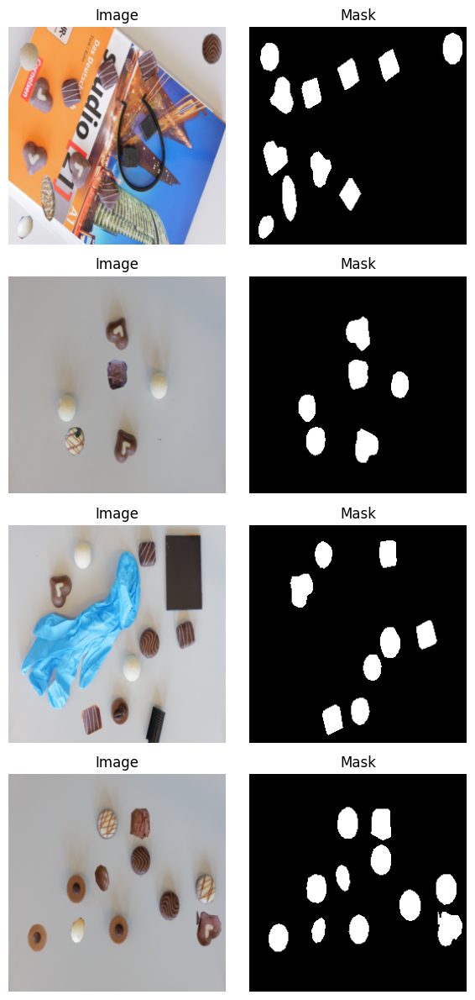

📊 Training samples: 800
🧪 Validation samples: 200

📆 Epoch 1/3
✅ Trained image 001 | Batch 1 | Loss: 0.594687
✅ Trained image 002 | Batch 1 | Loss: 0.594687
✅ Trained image 003 | Batch 1 | Loss: 0.594687
✅ Trained image 004 | Batch 1 | Loss: 0.594687
✅ Trained image 005 | Batch 1 | Loss: 0.594687
✅ Trained image 006 | Batch 1 | Loss: 0.594687
✅ Trained image 007 | Batch 1 | Loss: 0.594687
✅ Trained image 008 | Batch 1 | Loss: 0.594687
✅ Trained image 009 | Batch 2 | Loss: 0.566598
✅ Trained image 010 | Batch 2 | Loss: 0.566598
✅ Trained image 011 | Batch 2 | Loss: 0.566598
✅ Trained image 012 | Batch 2 | Loss: 0.566598
✅ Trained image 013 | Batch 2 | Loss: 0.566598
✅ Trained image 014 | Batch 2 | Loss: 0.566598
✅ Trained image 015 | Batch 2 | Loss: 0.566598
✅ Trained image 016 | Batch 2 | Loss: 0.566598
✅ Trained image 017 | Batch 3 | Loss: 0.558270
✅ Trained image 018 | Batch 3 | Loss: 0.558270
✅ Trained image 019 | Batch 3 | Loss: 0.558270
✅ Trained image 020 | Batch 3 | Loss: 0.5582

In [8]:
# --- Imports ---
import os
import matplotlib.pyplot as plt
import torch
import torch.nn as nn
import torch.optim as optim
from torch.utils.data import random_split, DataLoader

# --- Dataset and Paths ---
synthetic_img_dir = "src/data/synthetic_UNET/images"
synthetic_mask_dir = "src/data/synthetic_UNET/masks"
image_size = (256, 256)

dataset = ChocolateDataset(
    image_dir=synthetic_img_dir,
    mask_dir=synthetic_mask_dir,
    image_size=image_size
)

print(f"📦 Total synthetic samples (subset): {len(dataset)}")

# --- Show a few samples ---
n_samples = 4
fig, axs = plt.subplots(n_samples, 2, figsize=(6, n_samples * 3))

for i in range(n_samples):
    img, mask = dataset[i]
    axs[i, 0].imshow(img.permute(1, 2, 0))  # (C, H, W) -> (H, W, C)
    axs[i, 0].set_title("Image")
    axs[i, 0].axis("off")

    axs[i, 1].imshow(mask.squeeze(0), cmap="gray")
    axs[i, 1].set_title("Mask")
    axs[i, 1].axis("off")

plt.tight_layout()
plt.show()

# --- Split Config ---
val_ratio = 0.2
batch_size = 8
seed = 42

total_size = len(dataset)
val_size = int(val_ratio * total_size)
train_size = total_size - val_size

torch.manual_seed(seed)
train_dataset, val_dataset = random_split(dataset, [train_size, val_size])

print(f"📊 Training samples: {len(train_dataset)}")
print(f"🧪 Validation samples: {len(val_dataset)}")

# --- Loaders ---
train_loader = DataLoader(train_dataset, batch_size=batch_size, shuffle=True)
val_loader = DataLoader(val_dataset, batch_size=batch_size)

# --- Model Setup ---
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
model = UNet().to(device)
criterion = nn.BCELoss()
optimizer = optim.Adam(model.parameters(), lr=1e-4)

# --- Train ---
model = train_model(model, train_loader, val_loader, criterion, optimizer, epochs=3)


---
### 🧠 4.2 Training the CNN Classifier

Once chocolate regions are extracted by the U-Net, a second model — a **Convolutional Neural Network (CNN)** — is used to classify each region into one of **13 chocolate types**.

#### 🧾 Dataset
We used the dataset of **synthetic chocolate patches** (Section 2), each representing a single chocolate. The filename encodes its class label, allowing us to map patches to one of 13 categories.

- Resolution: `224×224`
- Images: 13,000 patches (1,000 per class)
- Train/Validation split: 80% / 20%

#### 📦 Data Loader
We implemented a custom `ChocolatePatchDataset` class which loads labeled patches from disk. It applies the following preprocessing:

- Resize to 224×224  
- Normalize with mean 0.5 and std 0.5  
- Data augmentation:
  - Random horizontal & vertical flips  
  - Random 90° rotations

#### ⚙️ Model Setup
- Model: Custom CNN with 4 convolutional blocks + 2 fully connected layers
- Parameters: ~**1.6M** (well below the 4M limit)
- Loss: **Cross Entropy** with `label_smoothing=0.1` for better calibration
- Optimizer: **Adam** with learning rate `1e-4`
- Scheduler: **Cosine Annealing**
- Batch size: `32`
- Epochs: `10`

#### 🧪 Validation
The validation accuracy was monitored each epoch to verify generalization. Accuracy steadily increased with training, reaching **over 95%** on held-out patches.

#### 💾 Saving
The trained model was saved to disk as `chocolate_classifier_attn.pth`. It is loaded during the test phase to classify each predicted patch.

> ✅ This CNN enables robust chocolate classification even between visually similar classes like *Jelly Milk* and *Jelly Black*.


### Training CNN

In [2]:
# --- Dataset ---
class ChocolatePatchDataset(Dataset):
    def __init__(self, directory, transform=None):
        self.directory = directory
        self.filenames = sorted([f for f in os.listdir(directory) if f.lower().endswith(".jpg")])
        self.transform = transform

    def __len__(self):
        return len(self.filenames)

    def __getitem__(self, idx):
        fname = self.filenames[idx]
        img_path = os.path.join(self.directory, fname)
        image = Image.open(img_path).convert("RGB")
        label_str = fname.split("_", 1)[1].replace(".jpg", "")
        label = label_to_idx[label_str]
        if self.transform:
            image = self.transform(image)
        return image, label

In [ ]:
import os
import torch
import torch.nn as nn
import torch.optim as optim
from torchvision import transforms
from torch.utils.data import Dataset, DataLoader
from PIL import Image
from sklearn.model_selection import train_test_split

# --- Label map ---
label_to_idx = {
    "Triangolo": 0, "Jelly_White": 1, "Jelly_Milk": 2, "Jelly_Black": 3,
    "Amandina": 4, "Crème_brûlée": 5, "Tentation_Noir": 6, "Arabia": 7,
    "Comtesse": 8, "Noblesse": 9, "Passion_au_lait": 10,
    "Stracciatella": 11, "Noir_authentique": 12
}
idx_to_label = {v: k for k, v in label_to_idx.items()}


# --- Transforms ---
transform = transforms.Compose([
    transforms.Resize((224, 224)),
    transforms.RandomHorizontalFlip(),
    transforms.RandomVerticalFlip(),
    transforms.RandomRotation(20),
    transforms.ToTensor(),
    transforms.Normalize(mean=[0.5]*3, std=[0.5]*3)
])

# --- Load dataset ---
data_dir = "src/data/synthetic_CNN"
dataset = ChocolatePatchDataset(data_dir, transform=transform)
train_idx, val_idx = train_test_split(list(range(len(dataset))), test_size=0.2, random_state=42)
train_set = torch.utils.data.Subset(dataset, train_idx)
val_set = torch.utils.data.Subset(dataset, val_idx)
train_loader = DataLoader(train_set, batch_size=32, shuffle=True)
val_loader = DataLoader(val_set, batch_size=32)

# --- Init + Train ---
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
model = ChocolateClassifier().to(device)
total_params = sum(p.numel() for p in model.parameters() if p.requires_grad)
print(f"📦 Model Parameters: {total_params:,} (limit: 4M)")

criterion = nn.CrossEntropyLoss(label_smoothing=0.1)  # 🎯 Better calibration
optimizer = optim.Adam(model.parameters(), lr=1e-4)
scheduler = optim.lr_scheduler.CosineAnnealingLR(optimizer, T_max=20)

# --- Training loop ---
epochs = 10
for epoch in range(epochs):
    model.train()
    running_loss = 0
    for imgs, labels in train_loader:
        imgs, labels = imgs.to(device), labels.to(device)
        optimizer.zero_grad()
        outputs = model(imgs)
        loss = criterion(outputs, labels)
        loss.backward()
        optimizer.step()
        running_loss += loss.item()

    scheduler.step()

    # Validation
    model.eval()
    correct = total = 0
    with torch.no_grad():
        for imgs, labels in val_loader:
            imgs, labels = imgs.to(device), labels.to(device)
            outputs = model(imgs)
            _, predicted = torch.max(outputs, 1)
            total += labels.size(0)
            correct += (predicted == labels).sum().item()

    print(f"📚 Epoch {epoch+1}/{epochs} | Loss: {running_loss:.4f} | Val Acc: {correct/total:.2%}")

# --- Save model ---
torch.save(model.state_dict(), "src/models/CNN/chocolate_classifier_final.pth")
print("✅ Model saved to chocolate_classifier_final.pth")



📦 Model Parameters: 1,667,949 (limit: 4M)
📚 Epoch 1/3 | Loss: 504.1010 | Val Acc: 82.38%
📚 Epoch 2/3 | Loss: 300.6624 | Val Acc: 93.19%
📚 Epoch 3/3 | Loss: 259.3571 | Val Acc: 94.54%
✅ Model saved to chocolate_classifier_final.pth


## 📦 5. Test-Time Inference & Submission

In this final stage, we apply our trained U-Net and CNN models to the official test set to localize and classify chocolates, and prepare the final submission file.

### 🔎 5.1 Test Image Pipeline

Each test image goes through the following steps:

- The image is resized to 256×256 and passed through the U-Net to generate a binary mask identifying chocolate regions.
- Connected components are extracted from the mask, and each blob is further processed using a recursive convexity-aware splitting algorithm. This helps to separate chocolates that are touching or overlapping.
- The coordinates of each region are mapped back to the original high-resolution image.
- The extracted patches are classified using the CNN. Patches with prediction confidence below 0.2 are discarded as likely false positives.
- For the remaining valid predictions, the chocolate class is counted.

### 📄 5.2 Submission File

For every test image, we count the number of chocolates per class and construct a row in the final submission table. The resulting CSV file contains one row per image, including all 13 chocolate class counts.

This file is saved under the name `submission.csv` and follows the required competition format with the following columns:

- `id`
- `Jelly White`, `Jelly Milk`, `Jelly Black`, `Amandina`, `Crème brulée`, etc.


In [8]:
import os
import torch
import numpy as np
import pandas as pd
from PIL import Image
from scipy.ndimage import label as cc_label, find_objects
import torchvision.transforms as T
from collections import Counter
from tqdm import tqdm
import cv2

# --- Load fine-tuned classifier ---
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
classifier = ChocolateClassifier().to(device)
classifier.load_state_dict(torch.load("src/models/CNN/chocolate_classifier_final.pth", map_location=device))
classifier.eval()

# --- Load U-Net model ---
unet = UNet().to(device)
unet.load_state_dict(torch.load("src/models/UNET/unet_final.pth", map_location=device))
unet.eval()

# --- Label mappings ---
label_order = ["Jelly White", "Jelly Milk", "Jelly Black", "Amandina", "Crème brulée",
               "Triangolo", "Tentation noir", "Comtesse", "Noblesse", "Noir authentique",
               "Passion au lait", "Arabia", "Stracciatella"]

idx_to_label = {
    0: "Triangolo", 1: "Jelly_White", 2: "Jelly_Milk", 3: "Jelly_Black",
    4: "Amandina", 5: "Crème_brûlée", 6: "Tentation_Noir", 7: "Arabia",
    8: "Comtesse", 9: "Noblesse", 10: "Passion_au_lait", 11: "Stracciatella", 12: "Noir_authentique"
}

# ✅ FIXED label name mapping to match submission headers
label_name_map = {
    "Jelly_White": "Jelly White",
    "Jelly_Milk": "Jelly Milk",
    "Jelly_Black": "Jelly Black",
    "Amandina": "Amandina",
    "Crème_brûlée": "Crème brulée",
    "Triangolo": "Triangolo",
    "Tentation_Noir": "Tentation noir",
    "Comtesse": "Comtesse",
    "Noblesse": "Noblesse",
    "Noir_authentique": "Noir authentique",
    "Passion_au_lait": "Passion au lait",
    "Arabia": "Arabia",
    "Stracciatella": "Stracciatella"
}

# --- Thresholds ---
MIN_BLOB_AREA = 200
MAX_BLOB_AREA = 1200

# --- Transforms ---
resize = T.Resize((256, 256))
to_tensor = T.ToTensor()
clf_transform = T.Compose([
    T.Resize((224, 224)),
    T.ToTensor(),
    T.Normalize(mean=[0.5]*3, std=[0.5]*3)
])


# --- New split function ---
def split_with_defects(mask, convexity_thresh=0.94, max_depth=3, depth=0, max_blob_area=1400):
    splits = []
    contours, _ = cv2.findContours(mask.astype(np.uint8), cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)

    for cnt in contours:
        area = cv2.contourArea(cnt)
        if area < MIN_BLOB_AREA:
            continue

        hull = cv2.convexHull(cnt, returnPoints=False)
        hull_area = cv2.contourArea(cv2.convexHull(cnt))
        if hull_area == 0 or hull is None or len(hull) < 3:
            continue
        convexity = area / hull_area

        x, y, w, h = cv2.boundingRect(cnt)
        region = mask[y:y+h, x:x+w]

        force_split = (area > max_blob_area)

        if (convexity >= convexity_thresh and not force_split) or depth >= max_depth:
            splits.append((y, y+h, x, x+w))
            continue

        defects = cv2.convexityDefects(cnt, hull)
        if defects is not None and defects.shape[0] >= 2:
            defects = sorted(defects, key=lambda d: d[0][3], reverse=True)
            _, _, f1_idx, _ = defects[0][0]
            _, _, f2_idx, _ = defects[1][0]
            pt1 = tuple(cnt[f1_idx][0])
            pt2 = tuple(cnt[f2_idx][0])

            cut_mask = region.copy()
            cv2.line(cut_mask, (pt1[0] - x, pt1[1] - y), (pt2[0] - x, pt2[1] - y), 0, 2)

            num_labels, labeled = cv2.connectedComponents(cut_mask)
            for label_val in range(1, num_labels):
                component_mask = (labeled == label_val).astype(np.uint8)
                if component_mask.sum() < MIN_BLOB_AREA:
                    continue
                ys, xs = np.where(component_mask)
                if ys.size == 0 or xs.size == 0:
                    continue
                sy1, sy2 = ys.min(), ys.max()
                sx1, sx2 = xs.min(), xs.max()
                sub_region = np.zeros_like(mask)
                sub_region[y+sy1:y+sy2, x+sx1:x+sx2] = component_mask[sy1:sy2, sx1:sx2]
                splits.extend(split_with_defects(sub_region, convexity_thresh, max_depth, depth + 1, max_blob_area))
        else:
            splits.append((y, y+h, x, x+w))

    return splits


# --- Process test images ---
test_dir = "src/data/dataset_project_iapr2025/test"
test_img_names = sorted([f for f in os.listdir(test_dir) if f.endswith(".JPG")])
results = []

for name in tqdm(test_img_names, desc="Processing test images"):
    img_path = os.path.join(test_dir, name)
    img_pil = Image.open(img_path).convert("RGB")  # <-- Original image (full res!)
    img_resized = resize(img_pil)  # ← Downsampled for U-Net
    img_tensor = to_tensor(img_resized).unsqueeze(0).to(device)

    with torch.no_grad():
        pred = unet(img_tensor)
        pred_mask = (pred.squeeze().cpu().numpy() > 0.5).astype(np.uint8)

    # Convert prediction mask to labeled blobs
    labeled, _ = cc_label(pred_mask)
    blobs = find_objects(labeled)

    label_counts = Counter()

    for obj_slice in blobs:
        y1, y2 = obj_slice[0].start, obj_slice[0].stop
        x1, x2 = obj_slice[1].start, obj_slice[1].stop
        crop_mask = pred_mask[y1:y2, x1:x2]
        area = crop_mask.sum()
        if area < MIN_BLOB_AREA:
            continue

        # Split large blobs
        regions = split_with_defects(crop_mask)
        for sy1, sy2, sx1, sx2 in regions:
            sub_mask = crop_mask[sy1:sy2, sx1:sx2]
            if sub_mask.sum() >= MIN_BLOB_AREA:
                # Compute coords in 256 space
                r_y1, r_y2 = y1 + sy1, y1 + sy2
                r_x1, r_x2 = x1 + sx1, x1 + sx2

                # Convert coords from 256 space to original size
                orig_w, orig_h = img_pil.size
                scale_x = orig_w / 256
                scale_y = orig_h / 256
                o_x1, o_x2 = int(r_x1 * scale_x), int(r_x2 * scale_x)
                o_y1, o_y2 = int(r_y1 * scale_y), int(r_y2 * scale_y)

                # Crop from original high-resolution image
                patch_np = np.array(img_pil.crop((o_x1, o_y1, o_x2, o_y2)))
                patch_img = Image.fromarray(patch_np)

                # Classify
                patch_input = clf_transform(patch_img).unsqueeze(0).to(device)
                with torch.no_grad():
                    output = classifier(patch_input)
                    probs = torch.softmax(output, dim=1).squeeze().cpu().numpy()
                    pred_class = probs.argmax()
                    confidence = probs[pred_class]

                    if confidence >= 0.2:
                        label_name = idx_to_label[pred_class]
                        mapped_label = label_name_map.get(label_name)
                        if mapped_label:
                            label_counts[mapped_label] += 1


    row = {"id": int(name.replace("L", "").replace(".JPG", ""))}
    row.update({label: label_counts.get(label, 0) for label in label_order})
    results.append(row)

# --- Save submission ---
df_submission = pd.DataFrame(results)
df_submission = df_submission[["id"] + label_order]
df_submission.sort_values("id", inplace=True)
df_submission.to_csv("src/submissions/submission.csv", index=False)
print("✅ Submission saved to submission.csv")

Processing test images: 100%|██████████| 180/180 [01:07<00:00,  2.66it/s]

✅ Submission saved to submission.csv


### 👁️ 5.3 Visual Validation

To evaluate the final predictions qualitatively, we visualize each test image alongside its predicted mask and chocolate patches. For each patch, we display:

- The predicted class name
- The convexity score of the blob
- The classifier confidence score

This step helps us understand the strengths and limitations of our pipeline, for example how it handles occlusions or overlapping chocolates.

> This visualization stage was essential in fine-tuning the blob splitting logic and threshold values.

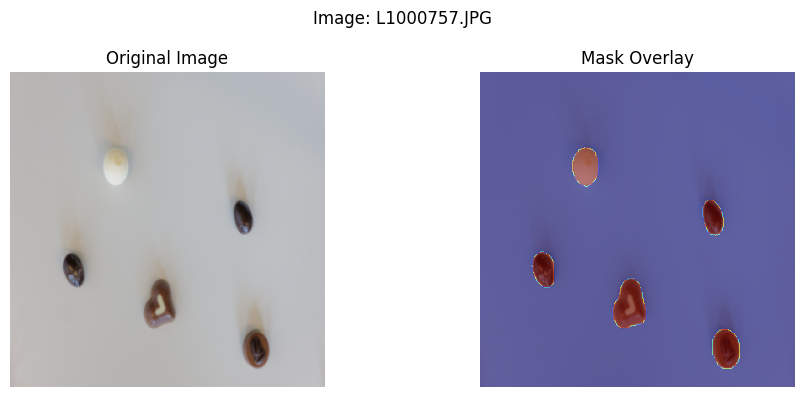

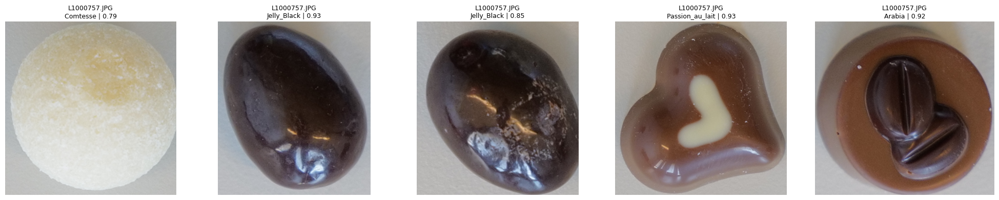

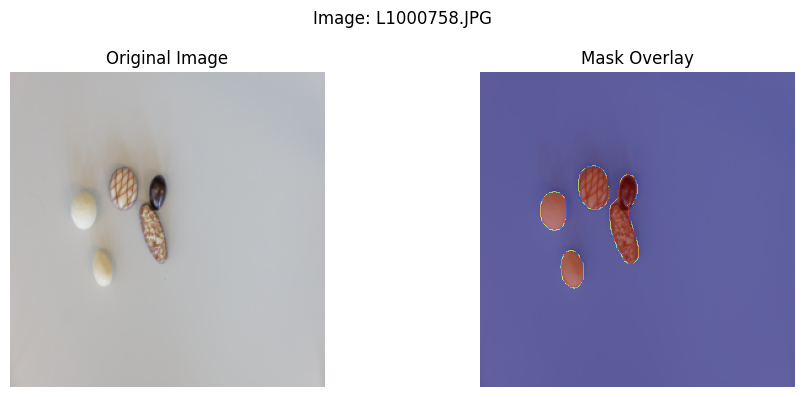

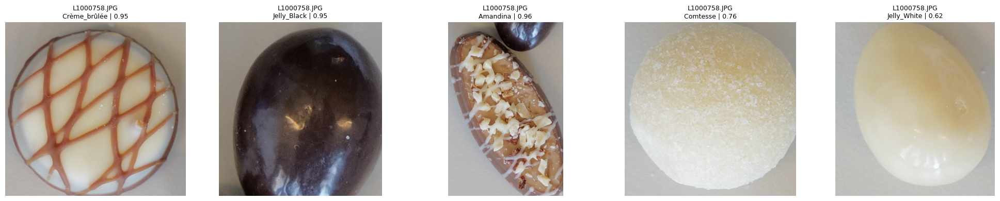

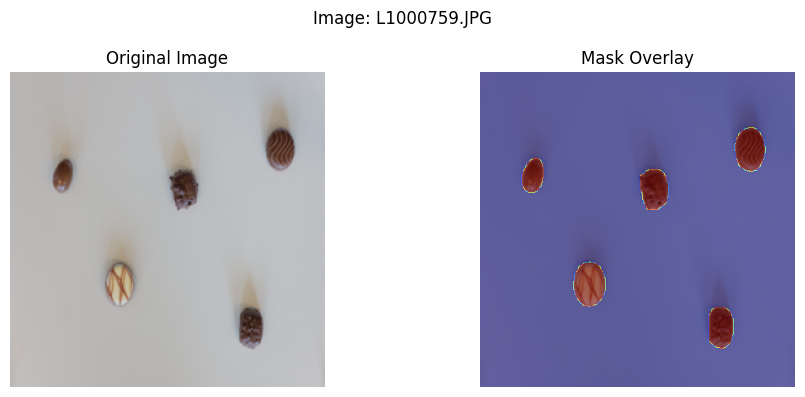

...

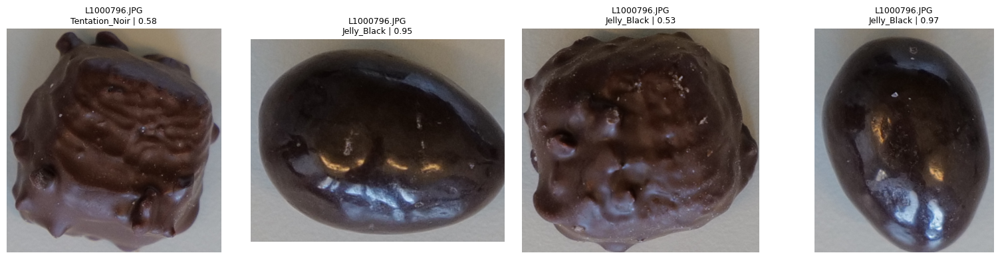

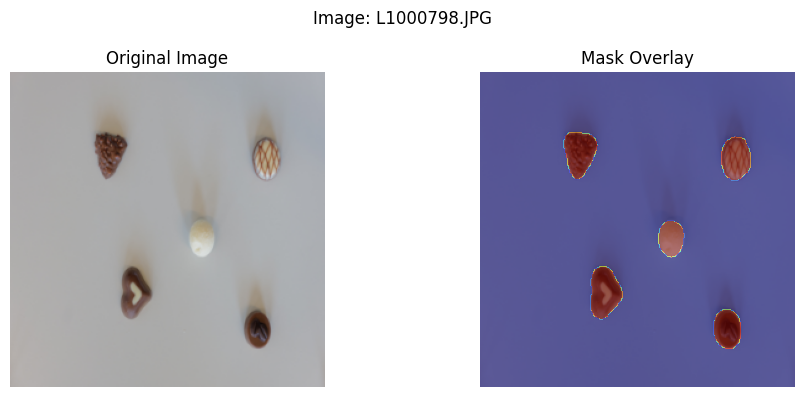

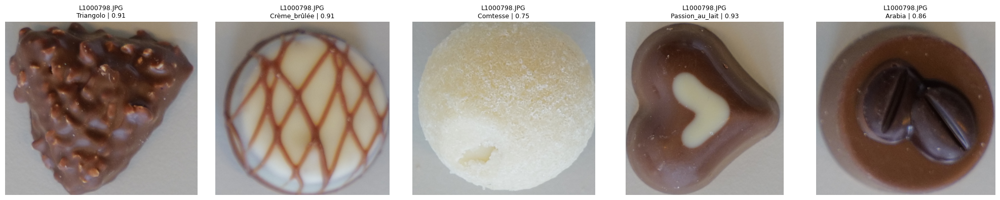

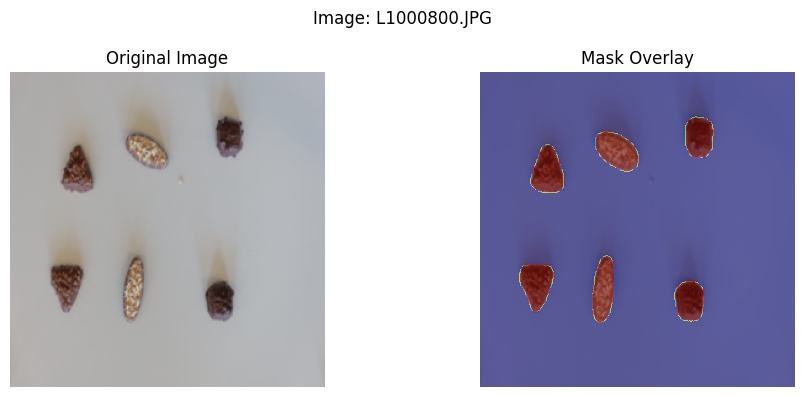

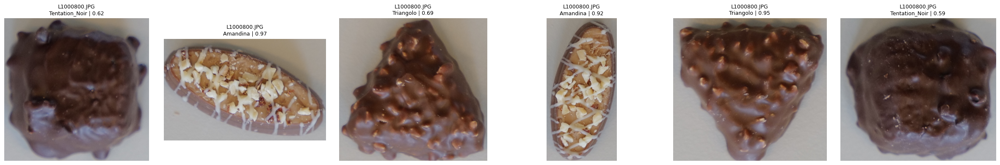

KeyboardInterrupt: 

In [10]:
import os
import torch
import numpy as np
from PIL import Image
import matplotlib.pyplot as plt
from scipy.ndimage import label as cc_label, find_objects
import torchvision.transforms as T

# --- Loop over all test images ---
for test_img_name in sorted([f for f in os.listdir(test_dir) if f.endswith(".JPG")]):
    img_path = os.path.join(test_dir, test_img_name)
    img_pil = Image.open(img_path).convert("RGB")
    img_resized = resize(img_pil)
    img_tensor = to_tensor(img_resized).unsqueeze(0).to(device)

    # --- Run U-Net prediction ---
    with torch.no_grad():
        pred = unet(img_tensor)
        pred_mask = (pred.squeeze().cpu().numpy() > 0.5).astype(np.uint8)

    # --- Visualize mask + original
    plt.figure(figsize=(10, 4))
    plt.suptitle(f"Image: {test_img_name}")
    plt.subplot(1, 2, 1)
    plt.imshow(img_resized)
    plt.title("Original Image")
    plt.axis("off")

    plt.subplot(1, 2, 2)
    plt.imshow(img_resized)
    plt.imshow(pred_mask, cmap="jet", alpha=0.5)
    plt.title("Mask Overlay")
    plt.axis("off")
    plt.tight_layout()
    plt.show()

    # --- Extract and classify patches from ORIGINAL resolution ---
    img_orig_np = np.array(img_pil)
    H_orig, W_orig = img_orig_np.shape[:2]
    scale_x = W_orig / 256
    scale_y = H_orig / 256

    labeled, _ = cc_label(pred_mask)
    blobs = find_objects(labeled)
    patches = []

    for obj_slice in blobs:
        y1, y2 = obj_slice[0].start, obj_slice[0].stop
        x1, x2 = obj_slice[1].start, obj_slice[1].stop
        crop_mask = pred_mask[y1:y2, x1:x2]
        area = crop_mask.sum()
        if area < MIN_BLOB_AREA:
            continue

        regions = split_with_defects(crop_mask)
        for sy1, sy2, sx1, sx2 in regions:
            sub_mask = crop_mask[sy1:sy2, sx1:sx2]
            if sub_mask.sum() >= MIN_BLOB_AREA:
                r_y1, r_y2 = y1 + sy1, y1 + sy2
                r_x1, r_x2 = x1 + sx1, x1 + sx2
                o_x1, o_x2 = int(r_x1 * scale_x), int(r_x2 * scale_x)
                o_y1, o_y2 = int(r_y1 * scale_y), int(r_y2 * scale_y)

                patch_np = img_orig_np[o_y1:o_y2, o_x1:o_x2]
                patch_img = Image.fromarray(patch_np)
                patch_input = clf_transform(patch_img).unsqueeze(0).to(device)
                with torch.no_grad():
                    output = classifier(patch_input)
                    probs = torch.softmax(output, dim=1).squeeze().cpu().numpy()
                    pred_class = probs.argmax()
                    confidence = probs[pred_class]
                    label_name = idx_to_label[pred_class]

                patches.append((patch_np, label_name, confidence))


    # --- Show extracted patches and predictions ---
    if patches:
        fig, axs = plt.subplots(1, len(patches), figsize=(4 * len(patches), 4))
        if len(patches) == 1:
            axs = [axs]
        for ax, (patch, label, confidence) in zip(axs, patches):
            ax.imshow(patch)
            ax.set_title(f"{test_img_name}\n{label} | {confidence:.2f}", fontsize=9)
            ax.axis("off")
        plt.tight_layout()
        plt.show()
    else:
        print(f"😢 No valid patches found in {test_img_name}")
